In [60]:
import pandas as pd
from PIL import Image 
from pytesseract import image_to_string
import pytesseract
import sys 
from pdf2image import convert_from_path 
import os 
from IPython import display
import cv2
import imutils
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'

## Read the PDF file and save the contents page as an Image

In [22]:
PDF_file = 'CP 2009-11.pdf'

pages = convert_from_path(PDF_file, 1000, first_page=3, last_page=3) 

In [23]:
image_name = 'ContentsPage.jpg'

pages[0].save(image_name,'JPEG')

In [34]:
img = Image.open(image_name)
img

## Crop required portion of the contents page

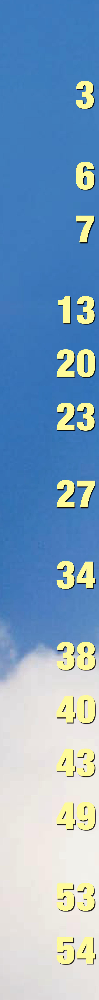

In [126]:
w, h = img.size
area = (2500, 1200, 3250, h-2000)
small_area = (3170, 1950, 3200, 2000)
small = img.crop(small_area)
cropped_img = img.crop(area)

# thresh = 235
# fn = lambda x : 0 if x > thresh else 255
# cropped_img = cropped_img.convert('L').point(fn, mode='1')
cropped_img

## Edit the pixel values to change color to grayscale

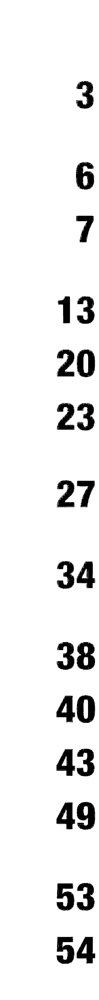

In [137]:
temp = cropped_img.copy()
im = temp.load()

r_low = 245
r_high = 255
g_low = 240
g_high = 255
b_low = 140
b_high = 170

for x in range(0,temp.size[0]):
    for y in range(0,temp.size[1]):
        
        if (im[x,y][0] >= r_low and im[x,y][0] <= r_high) and (im[x,y][1] >= g_low and im[x,y][1] <= g_high) and (im[x,y][2] >= b_low and im[x,y][2] <= b_high):
            im[x,y] = (0,0,0)

        else:
#             print(x,y,'---->',im[x,y])
            im[x,y] = (255,255,255)

temp = temp.resize((160,900),Image.ANTIALIAS)
temp

## Use PyTesseract to extract digits, using the right config

'--psm 6 -c tessedit_char_whitelist=0123456789'

In [149]:
config = "--psm 6 -c tessedit_char_whitelist=0123456789"
text = str(((image_to_string(temp,config=config))))
text = text.replace('-\n', '') 
print(text)

3

6

7
13
20
23
27
34
33
40
43
49
53
54
